In [1]:
import math
import functools
from typing import Dict, Tuple

import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.pyplot as plt

import jax 
import jax.numpy as jnp
from typing import Dict

from qdax.core.map_elites import MAPElites
from qdax.core.containers.mapelites_repertoire import compute_euclidean_centroids, MapElitesRepertoire

from qdax import environments
from qdax.core.neuroevolution.buffers.buffer import QDTransition
from qdax.core.neuroevolution.networks.networks import MLP
from qdax.tasks.brax_envs import (
    scoring_function_brax_envs,
    reset_based_scoring_function_brax_envs,
    make_policy_network_play_step_fn_brax
)
from qdax.custom_types import EnvState, Params, RNGKey
from qdax.core.containers.mapelites_repertoire import (
    MapElitesRepertoire,
    compute_cvt_centroids,
)

from qdax_es.core.custom_repertoire_mapelites import CustomMAPElites
from qdax_es.core.containers.gp_repertoire import GPRepertoire
from qdax_es.core.containers.mae_repertoire import MAERepertoire

from qdax_es.utils.count_plots import plot_archive_value

from qdax_es.utils.setup import setup_qd

I0000 00:00:1719332936.172921  140074 tfrt_cpu_pjrt_client.cc:349] TfrtCpuClient created.


In [2]:
from jax.config import config
# config.update("jax_debug_nans", True)

In [3]:
# ES params
es_pop = 32
sigma_g = .05

# JEDi params
pool_size = 16 #@param {type:"integer"}
es_gens = 100
wtfs_alpha = 0.5
weighted_gp = True

batch_size = es_pop * pool_size #@param {type:"integer"}
print("batch_size", batch_size)
initial_batch = batch_size

env_name = "kheperax_snake"
episode_length = 250
stochastic = False
total_evaluations = 1e6
steps = 10
seed = 42
policy_hidden_layer_sizes = (8,)
activation = "relu"

num_init_cvt_samples = 50000
num_centroids = 1024

es_type = "Sep_CMA_ES"

num_iterations = int(total_evaluations / batch_size / steps) 
print("Iterations per step: ", num_iterations)
print("Iterations: ", num_iterations*steps)


from evosax import Strategies
assert es_type in Strategies, f"{es_type} is not one of {Strategies.keys()}"

batch_size 512
Iterations per step:  195
Iterations:  1950


## Setup

In [4]:
es_params = {
    "sigma_init": sigma_g,
    "popsize": es_pop,
}

repertoire_kwargs = {
    "n_steps": 100,
    "weighted": weighted_gp,
}

setup_config = {
    "seed": seed, 
    "env": env_name,
    "episode_length": episode_length,
    "stochastic": stochastic,
    "policy_hidden_layer_sizes": policy_hidden_layer_sizes,
    "activation": activation,
    "initial_batch": initial_batch,
    "num_init_cvt_samples": num_init_cvt_samples,
    "num_centroids": num_centroids,
}

In [5]:
(
    centroids, 
    min_bd, 
    max_bd, 
    scoring_fn, 
    metrics_fn, 
    init_variables, 
    key
) = setup_qd(setup_config)

<class 'kheperax.final_distance.FinalDistKheperaxTask'>


## Emitter

In [6]:
import importlib

jedi_mod = importlib.import_module("qdax_es.core.emitters.jedi_emitter")
jedi_mod = importlib.reload(jedi_mod)

jedi_pool_mod = importlib.import_module("qdax_es.core.emitters.jedi_pool_emitter")
jedi_pool_mod = importlib.reload(jedi_pool_mod)

JEDiEmitter = jedi_mod.JEDiEmitter
UniformJEDiPoolEmitter = jedi_pool_mod.UniformJEDiPoolEmitter
GPJEDiPoolEmitter = jedi_pool_mod.GPJEDiPoolEmitter

from qdax_es.utils.restart import FixedGens, ConvergenceRestarter

restarter = FixedGens(es_gens)

emitter = JEDiEmitter(
    centroids=centroids,
    es_hp=es_params,
    es_type=es_type,
    wtfs_alpha = wtfs_alpha,
    restarter=restarter,
    global_norm=False,
)

In [7]:
emitter = GPJEDiPoolEmitter(
    pool_size=pool_size,
    emitter=emitter
)

In [8]:
repertoire_type = GPRepertoire

map_elites = CustomMAPElites(
    scoring_function=scoring_fn,
    emitter=emitter,
    metrics_function=metrics_fn,
    repertoire_type=repertoire_type,
)

In [9]:
with jax.disable_jit():
    repertoire, emitter_state, key = map_elites.init(
        init_variables, 
        centroids, 
        key,
        repertoire_kwargs=repertoire_kwargs
    )

/home/paul/QDax_ES/qdax_es/core/containers/gp_repertoire.py:40: UserWarning: This type of repertoire does not store the extra scores computed by the scoring function
  repertoire = super().init(


Using ANNReshaper
Genotype dim: 66


In [10]:
# with jax.disable_jit():
# map_elites.update(repertoire, emitter_state, key);

  0%|          | 0/10 [00:00<?, ?it/s]

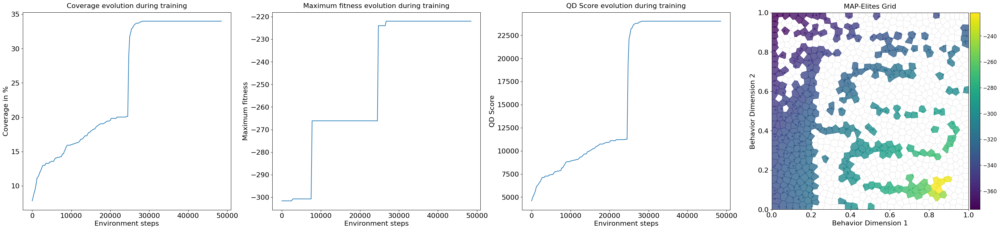

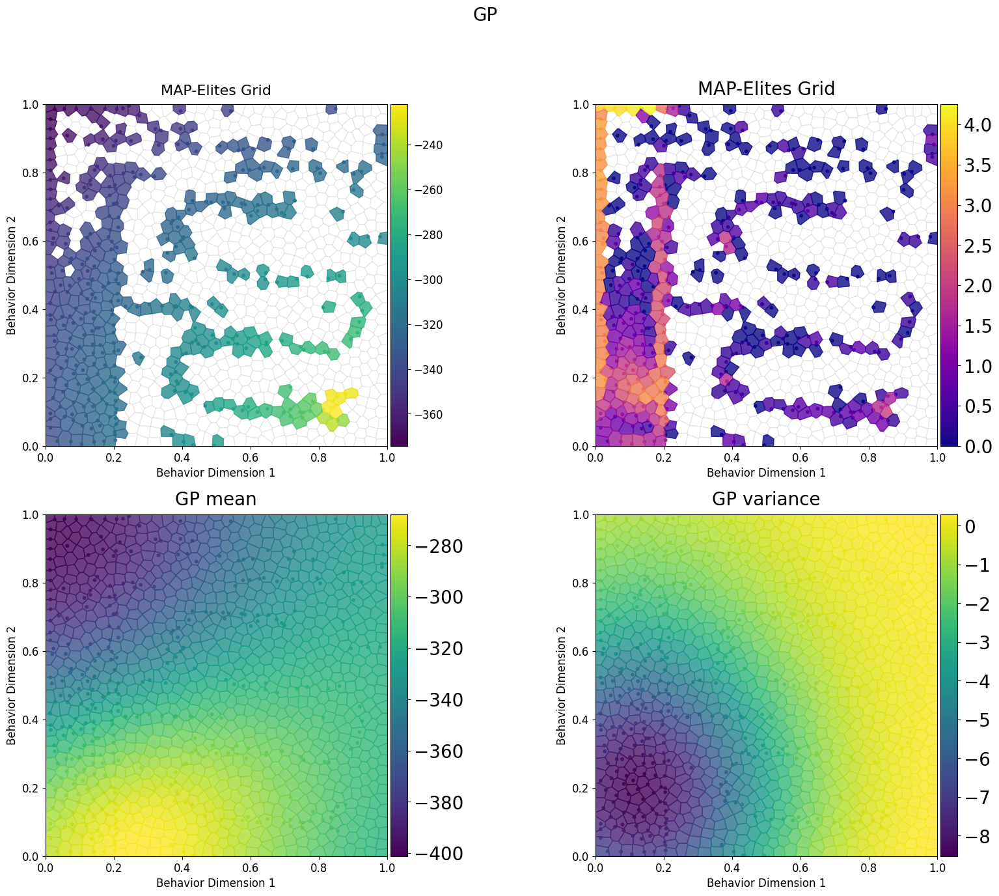

 10%|█         | 1/10 [00:20<03:04, 20.47s/it]

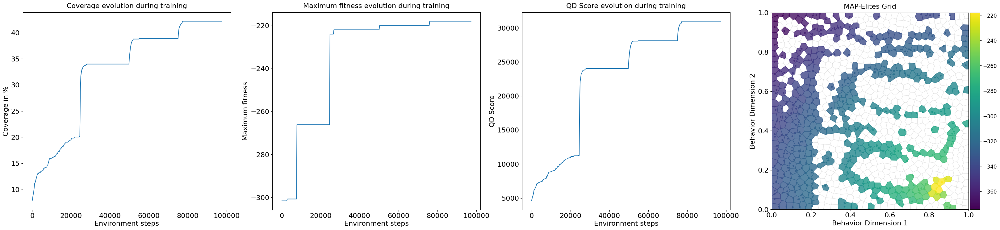

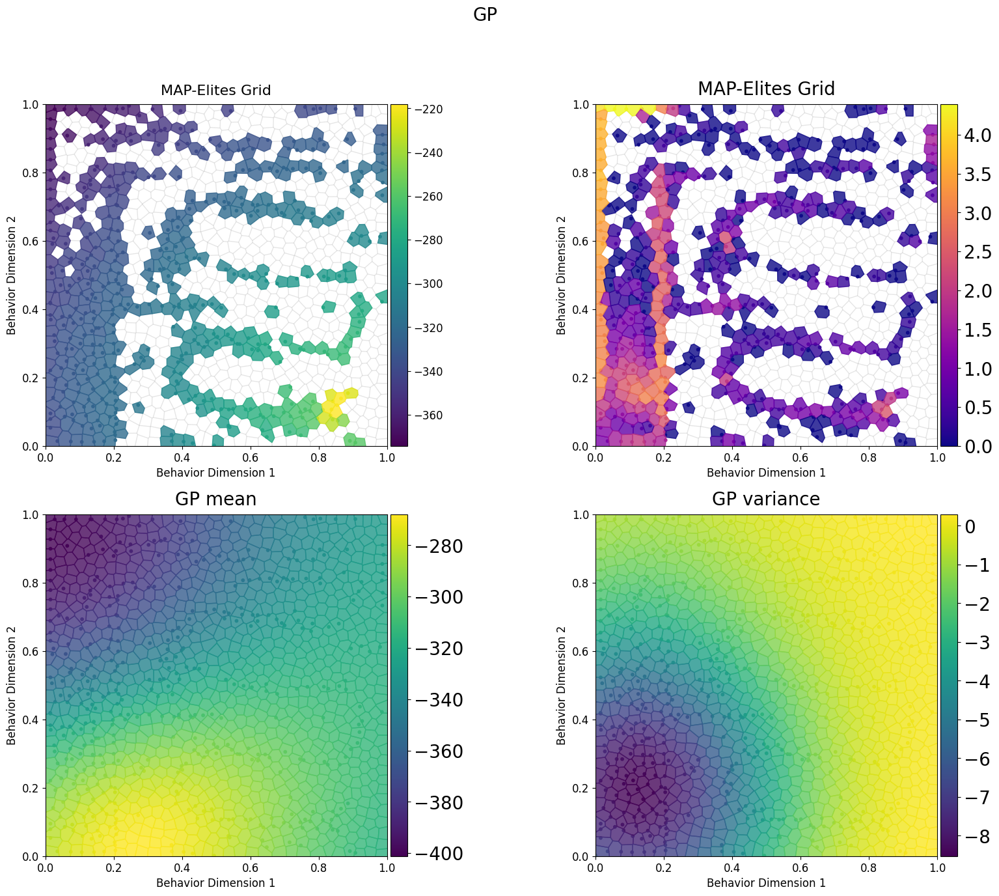

 20%|██        | 2/10 [00:37<02:29, 18.64s/it]

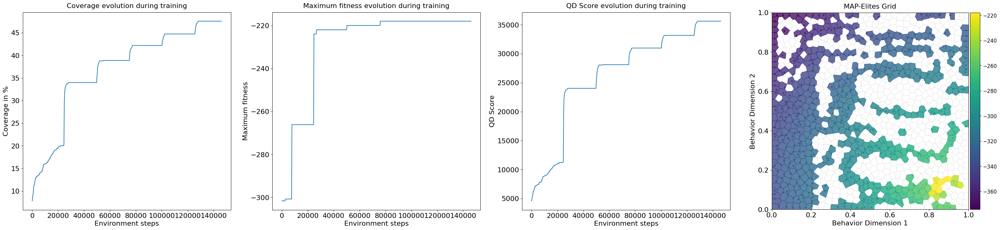

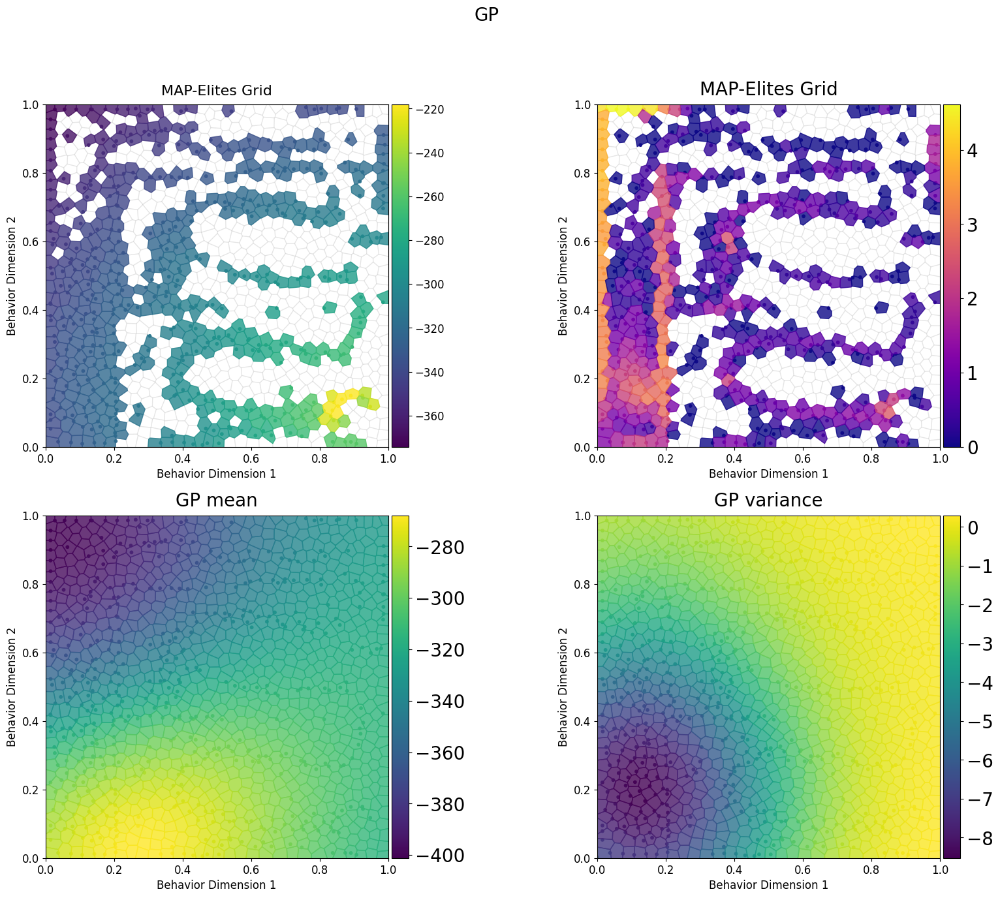

 30%|███       | 3/10 [00:55<02:07, 18.23s/it]

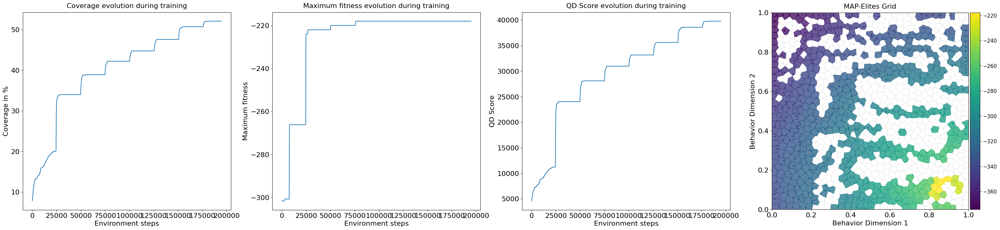

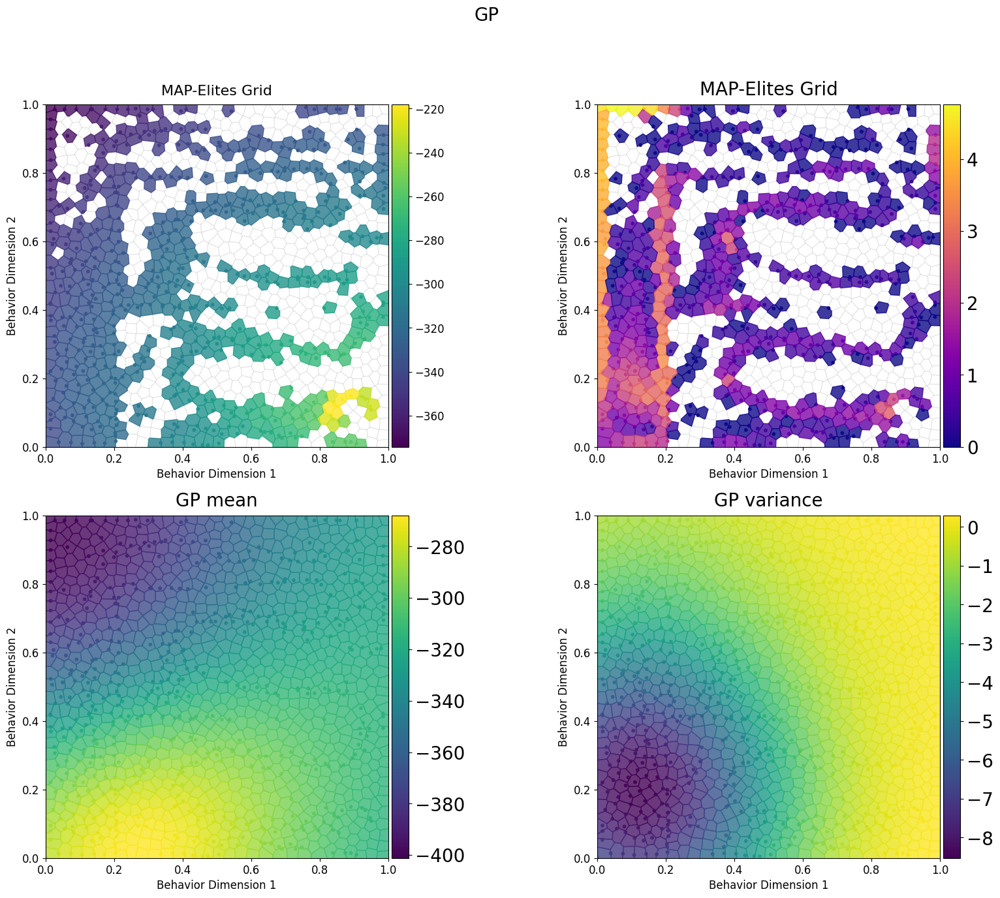

 40%|████      | 4/10 [01:13<01:47, 17.97s/it]

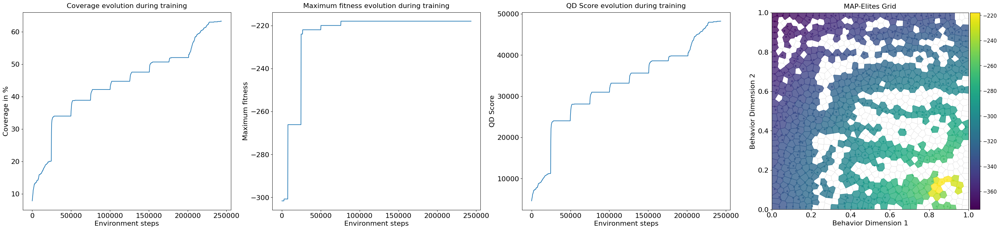

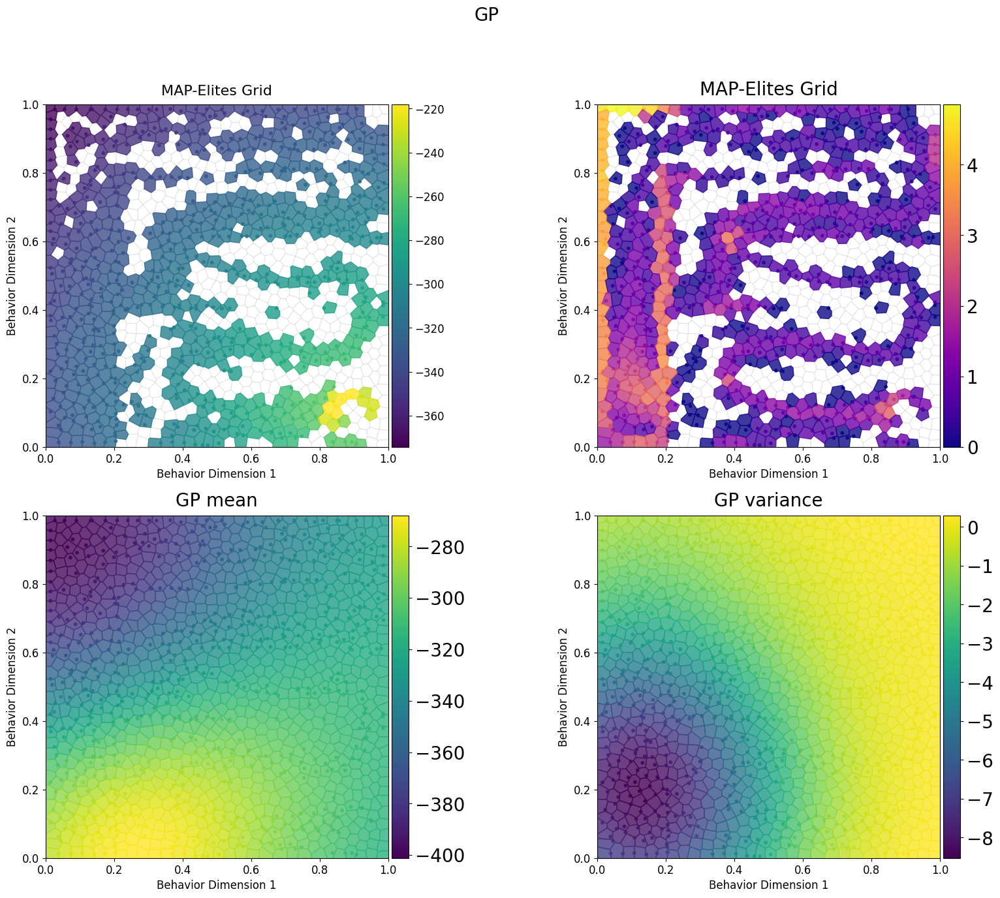

 50%|█████     | 5/10 [01:31<01:29, 17.95s/it]

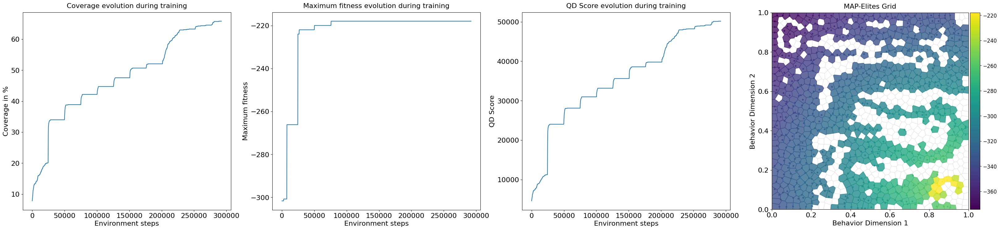

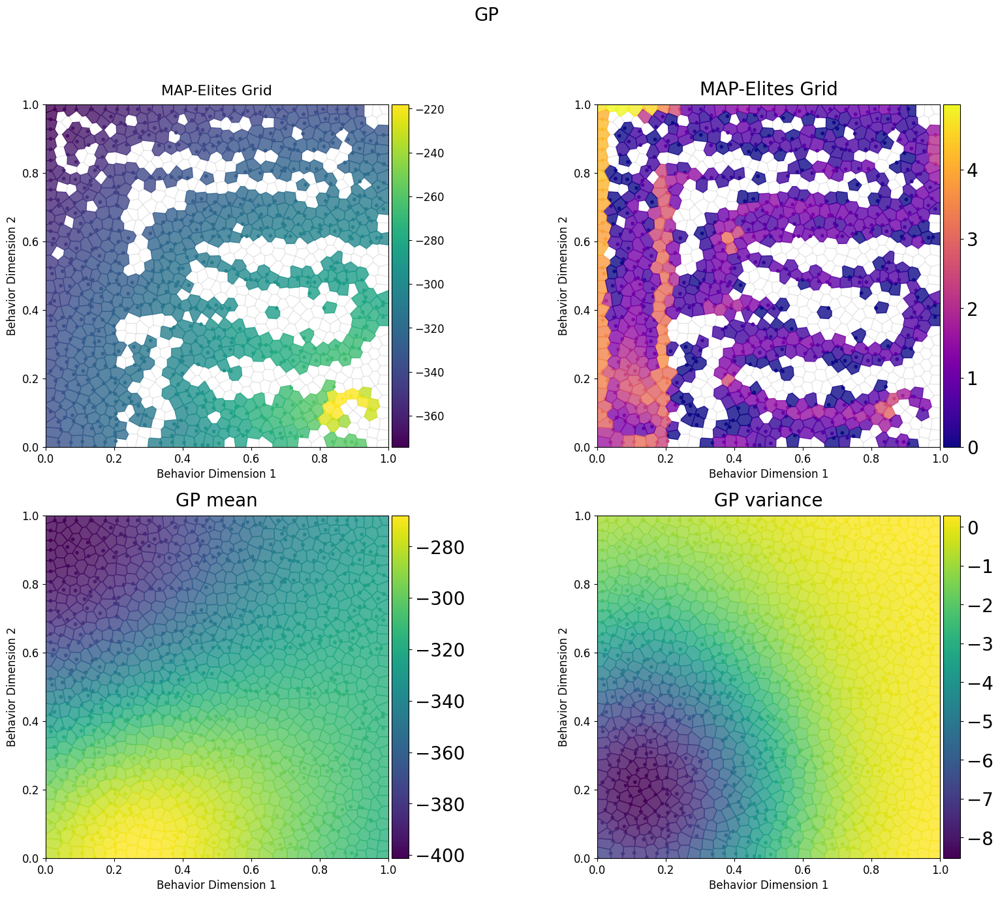

 60%|██████    | 6/10 [01:49<01:12, 18.01s/it]

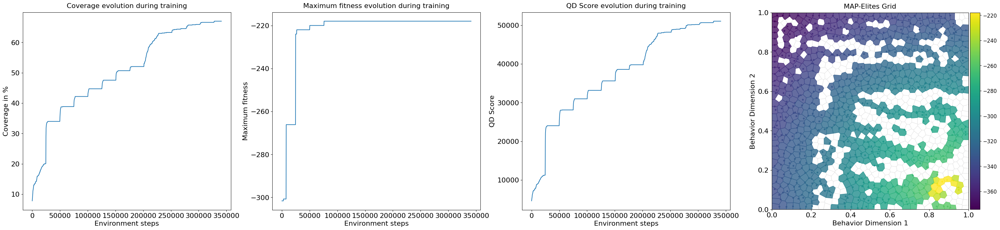

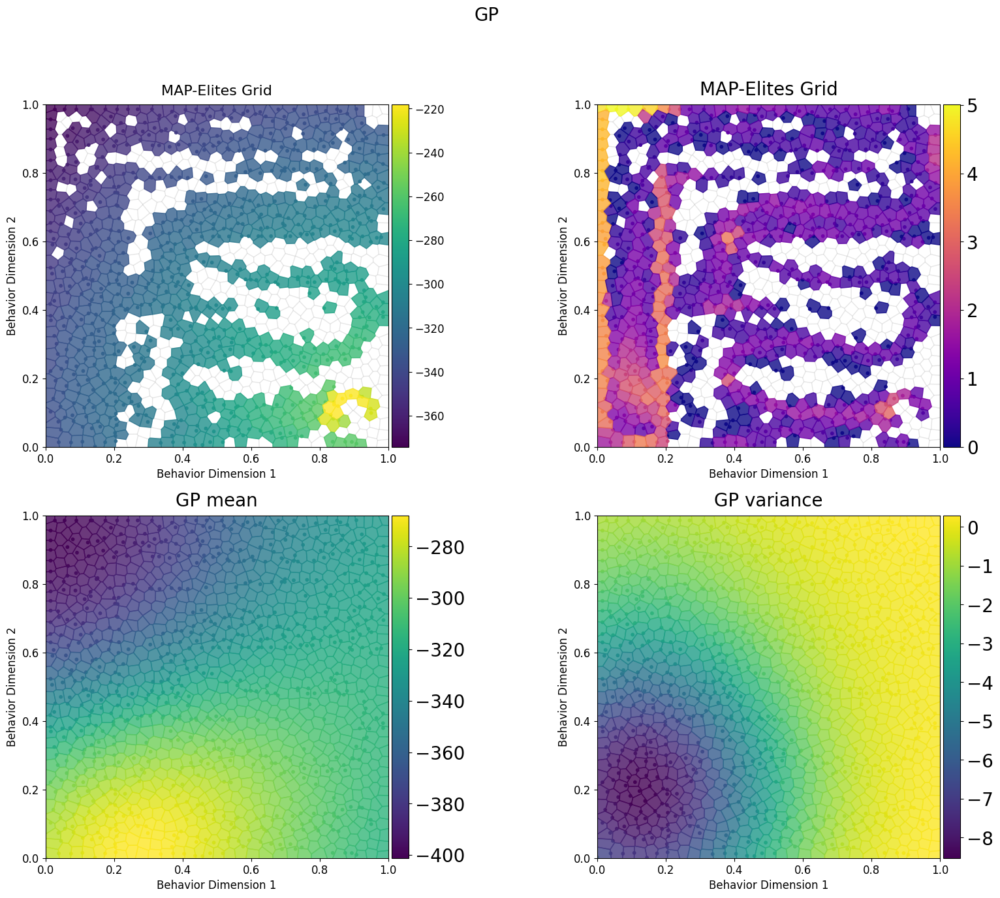

 70%|███████   | 7/10 [02:07<00:54, 18.27s/it]

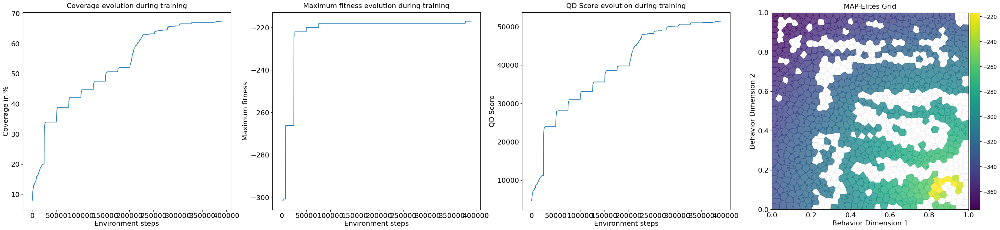

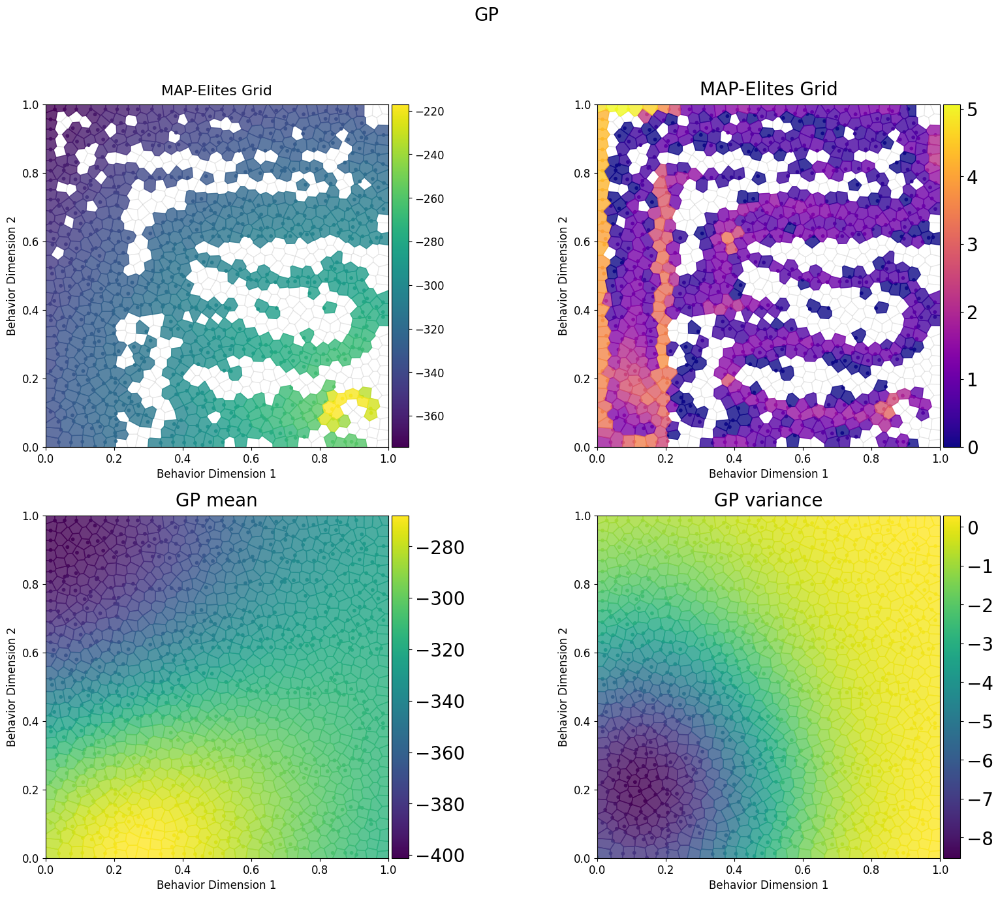

 80%|████████  | 8/10 [02:26<00:36, 18.30s/it]

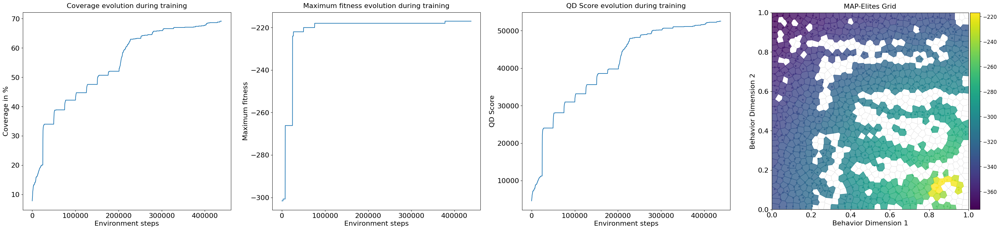

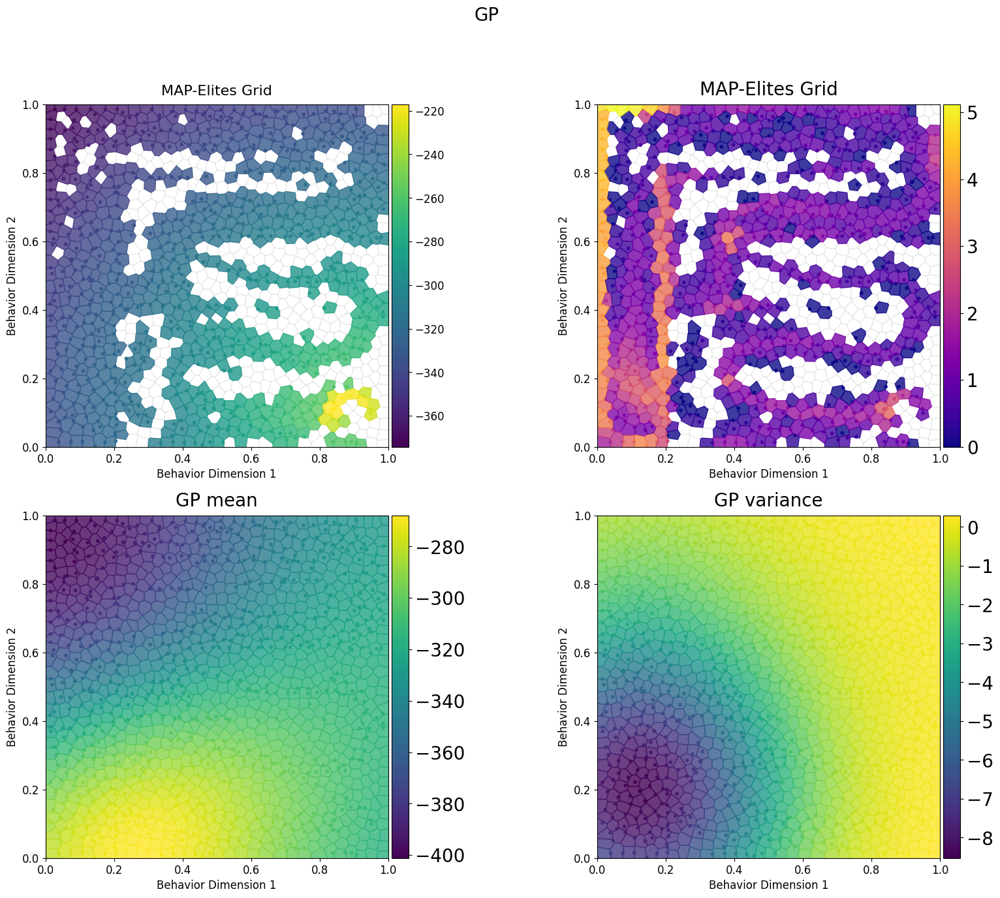

 90%|█████████ | 9/10 [02:44<00:18, 18.23s/it]

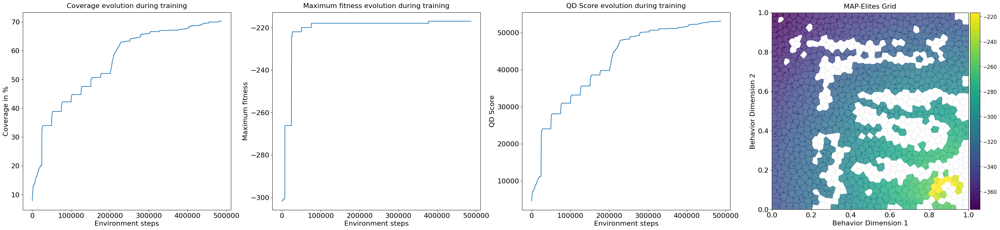

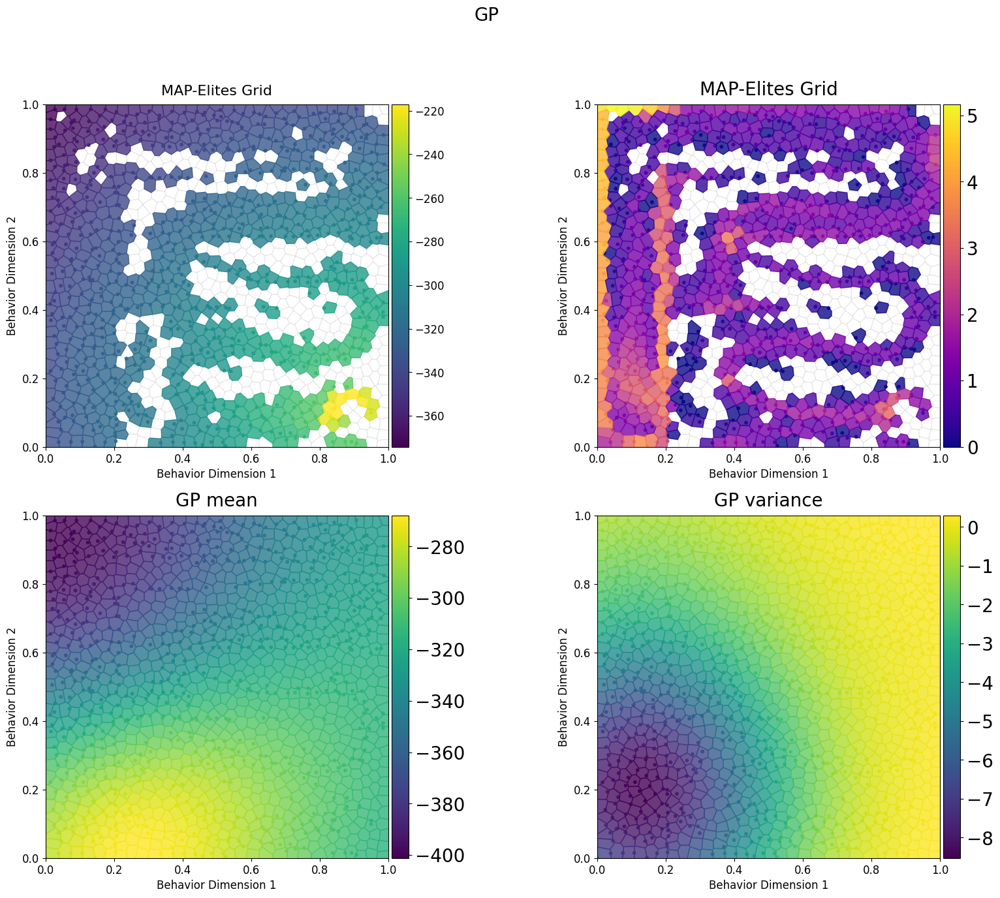

100%|██████████| 10/10 [03:02<00:00, 18.27s/it]


In [11]:
env_steps = jnp.arange(num_iterations) * emitter.batch_size * episode_length

from qdax.utils.plotting import plot_map_elites_results
import matplotlib
from tqdm import tqdm
%matplotlib inline

# %%time

metrics = {}
iter = 0
for step in tqdm(range(steps)):
    (repertoire, emitter_state, key,), step_metrics = jax.lax.scan(
        map_elites.scan_update,
        (repertoire, emitter_state, key),
        (),
        length=int(num_iterations),
    )
    if metrics:
        for k in step_metrics.keys():
            metrics[k] = jnp.concatenate([metrics[k], step_metrics[k]])
    else:
        metrics = step_metrics
    iter += num_iterations

    env_steps = jnp.arange(iter)  * episode_length
    fig, axes = plot_map_elites_results(
        env_steps=env_steps,
        metrics=metrics,
        repertoire=repertoire,
        min_bd=min_bd,
        max_bd=max_bd,
    )
    plt.ticklabel_format(style='sci', axis='x', scilimits=(0,0))
    plt.show()
    final_repertoire = repertoire.fit_gp(1000)
    fig, axes = final_repertoire.plot(min_bd, max_bd);
    plt.show()

In [12]:
metrics["coverage"].shape

(1950,)

In [13]:
for k, v in metrics.items():
    print(f"{k} after {num_iterations * batch_size}: {v[-1]}")

coverage after 99840: 70.21484375
max_count after 99840: 147041.0
max_fitness after 99840: -217.0
mean_count after 99840: 975.5
median_count after 99840: 4.0
min_count after 99840: 0.0
qd_score after 99840: 53098.609375
std_count after 99840: 8132.45166015625


In [14]:
repertoire.total_count

Array(998912., dtype=float32)

In [15]:
emitter_state.emitter_states.restart_state

RestartState(generations=Array([32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32, 32],      dtype=int32, weak_type=True))

## Plot results

ValueError: x and y must have same first dimension, but have shapes (195,) and (1950,)

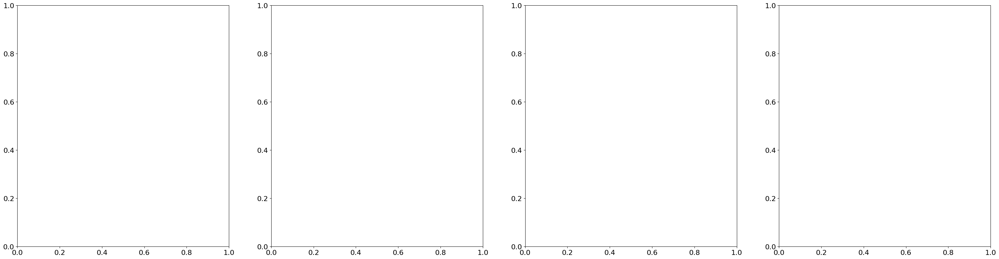

In [16]:
env_steps = jnp.arange(num_iterations) * emitter.batch_size * episode_length

from qdax.utils.plotting import plot_map_elites_results
import matplotlib

%matplotlib inline
fig, axes = plot_map_elites_results(
    env_steps=env_steps,
    metrics=metrics,
    repertoire=repertoire,
    min_bd=min_bd,
    max_bd=max_bd,
)

# main title
plt.suptitle(f"{env_name} task with {es_type} for JEDi", fontsize=20)

# udpate this variable to save your results locally
savefig = True
if savefig:
    figname = f"./plots/{env_name}/{es_type}_JEDi.png"
    # create folder if it does not exist
    import os
    os.makedirs(os.path.dirname(figname), exist_ok=True)
    print("Save figure in: ", figname)
    plt.savefig(figname)

Save figure in:  ./plots/kheperax_pointmaze/Sep_CMA_ES_JEDi_0.3_count.png


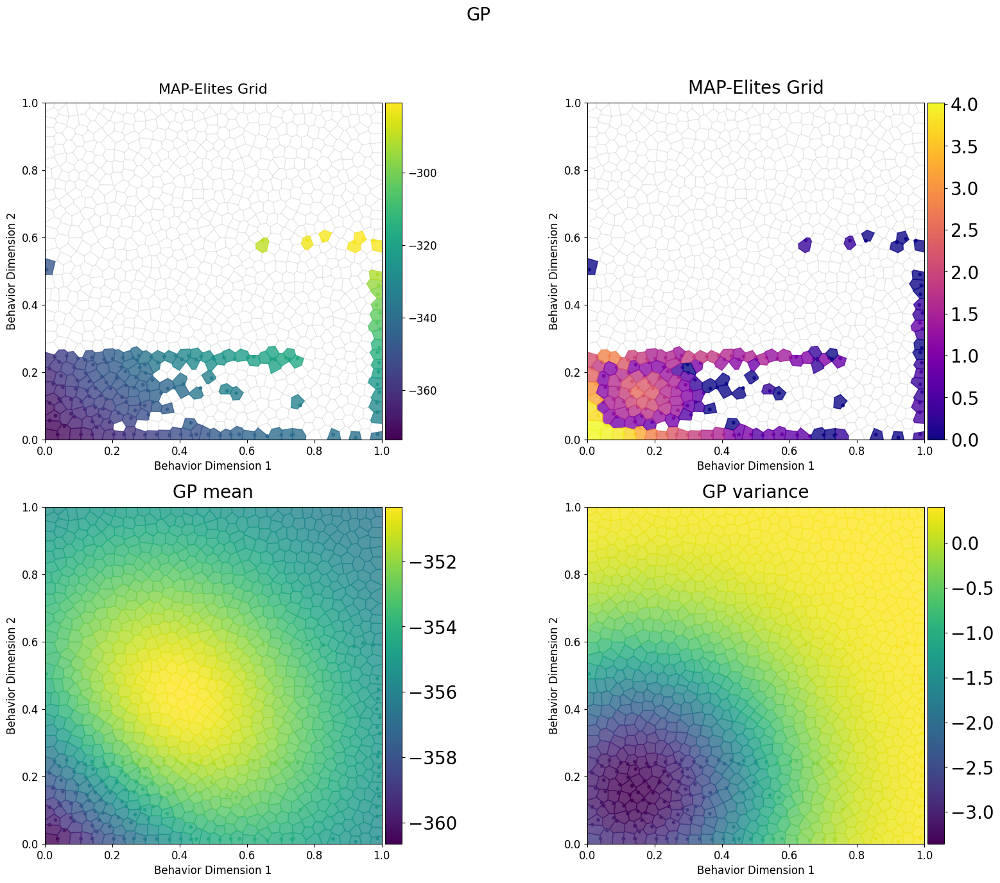

In [ ]:
final_repertoire = repertoire.fit_gp(10)
fig, axes = final_repertoire.plot(min_bd, max_bd);

if savefig:
    figname = f"./plots/{env_name}/{es_type}_JEDi_"  + str(wtfs_alpha) + "_count.png"
    # create folder if it does not exist
    import os
    os.makedirs(os.path.dirname(figname), exist_ok=True)
    print("Save figure in: ", figname)
    plt.savefig(figname)